<a href="https://colab.research.google.com/github/Mubashir2994/AIS-Project_SemanticSegmentation/blob/main/AIS_proj.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **AIS-Project_SemanticSegmentation**

### *Group C1-2*

# Step1: Installing the required libraries
### To start off, we need to install some important libraries. Since Detectron2 is based on Pytorch, so it needs to be installed. Since we have worked on Google Colab to utilize the benefits of free GPU which can save a lot of time for the training of the model. The following dependencies can be installed and imported

In [1]:
# install dependencies: 
!pip install pyyaml==5.1

!gcc --version
# opencv is pre-installed on colab

gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
!pip install torch==1.7.0 torchvision==0.8.1

In [ ]:
# To check the version of Pytorch
import torch
print(torch.__version__)

1.7.0


### Then we can use pip install to install Detectron2 library along with submodules that can be imported. 

In [ ]:
# install detectron2: ( CUDA 10.1 + torch 1.7)
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions

assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html


In [ ]:
# imprort detectron2
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np   
import cv2
import matplotlib.pyplot as plt

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

### Mounting Google Drive. The train and the test data is saved in the Google Drive in "Microcontroller Segmentation" folder that needs to be acquired. 

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


# Step2 : Registering the Dataset
### Since, we are using our custom created dataset so we need to tell Detectron2 where to get that dataset, for that we need to register our dataset. Hence, we wrote a method called get_indoor_dicts that returns the needed information like drawing bounding boxes around the annotated images and displaying their labels etc. 
### This method is written and parameters are defined, following the official Detectron2 documentation
https://detectron2.readthedocs.io/en/latest/tutorials/datasets.html

In [ ]:
import os
import numpy as np
import json
from detectron2.structures import BoxMode

def get_indoor_dicts(directory):
   
    classes = ['chair','lamp','cup','clock','fan','cell phone','fire extinguisher','kettle','iron','table','laptop']  #change here the classes
    dataset_dicts = []
    for filename in [file for file in os.listdir(directory) if file.endswith('.json')]:
        json_file = os.path.join(directory, filename)
        with open(json_file) as f:
            img_anns = json.load(f)

        record = {}
        
        filename = os.path.join(directory, img_anns["imagePath"])
        
        record["file_name"] = filename
        record["height"] = 600
        record["width"] = 900
      
        annos = img_anns["shapes"]
        objs = []
        for anno in annos:
            px = [a[0] for a in anno['points']]
            py = [a[1] for a in anno['points']]
            poly = [(x, y) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": classes.index(anno['label']),
                "iscrowd": 0
            }
            objs.append(obj)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts


### Next we can register the dataset using **DatasetCatalog.register** class. Detectron2 keeps track of a list of available datasets in a registry to be invoked for training. Furthermore, to access the data we can use **MetadataCatalog.get** class. 

In [ ]:

from detectron2.data import DatasetCatalog, MetadataCatalog
for d in ["train", "validation","test"]:
    DatasetCatalog.register("indoor_" + d, lambda d=d: get_indoor_dicts('Image Segmentation/' + d))
    MetadataCatalog.get("indoor_" + d).set(thing_classes=['chair','lamp','cup','clock','fan','cell phone','fire extinguisher','kettle','iron','table','laptop']) #Add classes here

# Later, to access the data
indoor_metadata = MetadataCatalog.get("indoor_train")

#Step3: Visualizing the training dataset
### In order to make sure that the training data has been imported correctly, Detectron2 makes it easy to view our training data with its module called **Visualizer**. 
### The training data is saved in the google drive with the path **drive/MyDrive/Indoor Segmentation/train**

In [ ]:
import random

dataset_dicts = get_indoor_dicts("Image Segmentation/train/")
for d in random.sample(dataset_dicts, 10):     #No of images to show
    img = cv2.imread(d["file_name"])
    v = Visualizer(img[:, :, ::-1], metadata=indoor_metadata, scale=0.5)
    v = v.draw_dataset_dict(d)
    plt.figure(figsize = (14, 10))            #Setting the size of the image to be displayed
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

FileNotFoundError: ignored

# Step4 : Training the model
### Since, we are using Detectron2 which is a pretrainied model, we only need to load in a configuration which can be fine-tuned for our custom dataset using the Defualt Trainer and selecting some weights. Detectron2 offers many model architectures for object detection in its model zoo. For instance segmentaion we have selected weights for the Faster RCNN. 

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))

#Passing the Training set
cfg.DATASETS.TRAIN = ("indoor_train",)
cfg.DATASETS.TEST = ()
#cfg.DATASETS.TEST = ("indoor_validation",) # Used for performance validation 

# Number of data loading threads
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

# Number of images per batch across all machines.
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025   # Setting up a good Learning Rate 
cfg.SOLVER.MAX_ITER = 4000     #Setting number of iterations
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 11 #Number of classes needed to be identified 
#cfg.TEST.EVAL_PERIOD = 2000   #Used for performance validation 

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)

[11/28 01:52:22 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:16, 10.5MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (12, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (12,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (44, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (44,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due 

In [ ]:
# Start training
trainer.train()

[11/28 01:53:04 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:363: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:363: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:103: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/

[11/28 01:53:36 d2.utils.events]:  eta: 1:45:39  iter: 19  total_loss: 3.567  loss_cls: 2.677  loss_box_reg: 0.1671  loss_mask: 0.6902  loss_rpn_cls: 0.006076  loss_rpn_loc: 0.007937  time: 1.5605  data_time: 0.0533  lr: 4.9953e-06  max_mem: 2676M
[11/28 01:54:08 d2.utils.events]:  eta: 1:45:13  iter: 39  total_loss: 3.386  loss_cls: 2.499  loss_box_reg: 0.1598  loss_mask: 0.6896  loss_rpn_cls: 0.006034  loss_rpn_loc: 0.009202  time: 1.5919  data_time: 0.0069  lr: 9.9902e-06  max_mem: 2676M
[11/28 01:54:40 d2.utils.events]:  eta: 1:45:29  iter: 59  total_loss: 3.088  loss_cls: 2.138  loss_box_reg: 0.2261  loss_mask: 0.6882  loss_rpn_cls: 0.01132  loss_rpn_loc: 0.007716  time: 1.5958  data_time: 0.0065  lr: 1.4985e-05  max_mem: 2676M
[11/28 01:55:12 d2.utils.events]:  eta: 1:45:19  iter: 79  total_loss: 2.465  loss_cls: 1.526  loss_box_reg: 0.1859  loss_mask: 0.6773  loss_rpn_cls: 0.004949  loss_rpn_loc: 0.006654  time: 1.5909  data_time: 0.0068  lr: 1.998e-05  max_mem: 2676M
[11/28 01:

# Step5: Loading the model
### Once the training is done successfully, the model automatically gets saved as a **.pth** file in the output folder. This file can then be used to load the model and make predictions. Note that the predictions should be made using **Default Predictor** class


In [ ]:
#Use the final weights generated after successful training for inference
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model

#Pass the test dataset
cfg.DATASETS.TEST = ("indoor_test", )
predictor = DefaultPredictor(cfg) 

# Step 6: Making inference with the model
### Now finaly, we can use our trained detectron2 model to perform semectic segmentation on the images that the model has neven seen before. We are taking the images from the test folder and we can make predictions using the Detectron2 predictor class. 

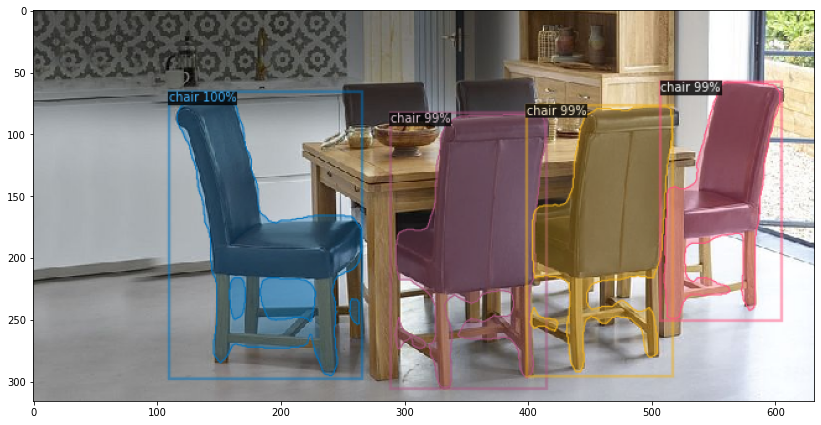

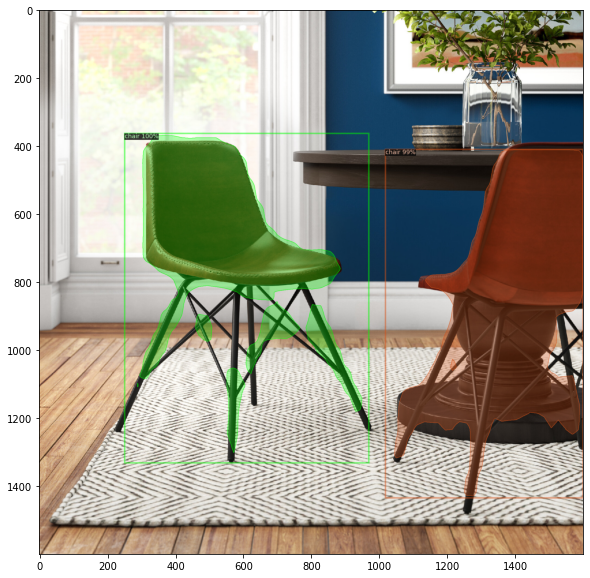

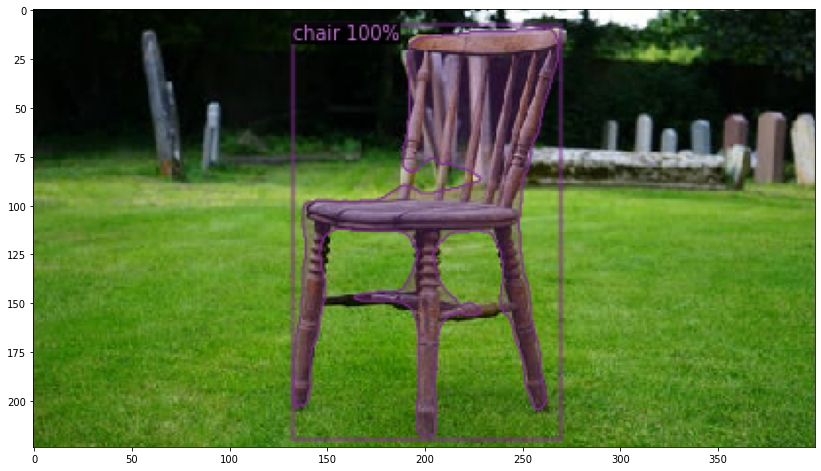

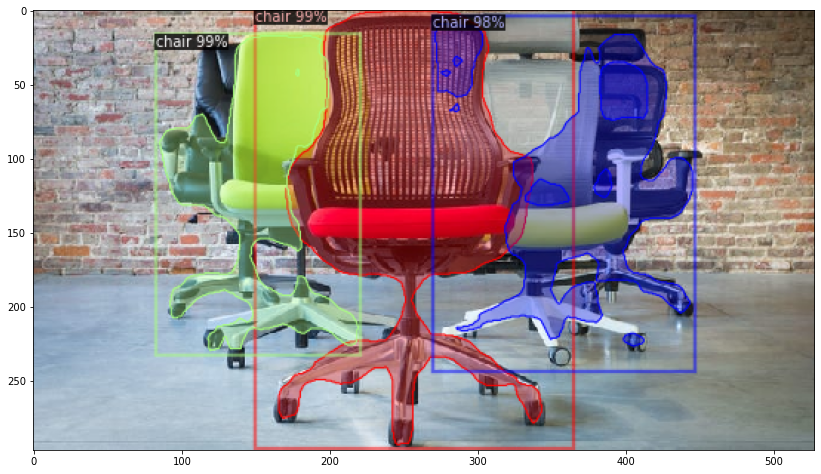

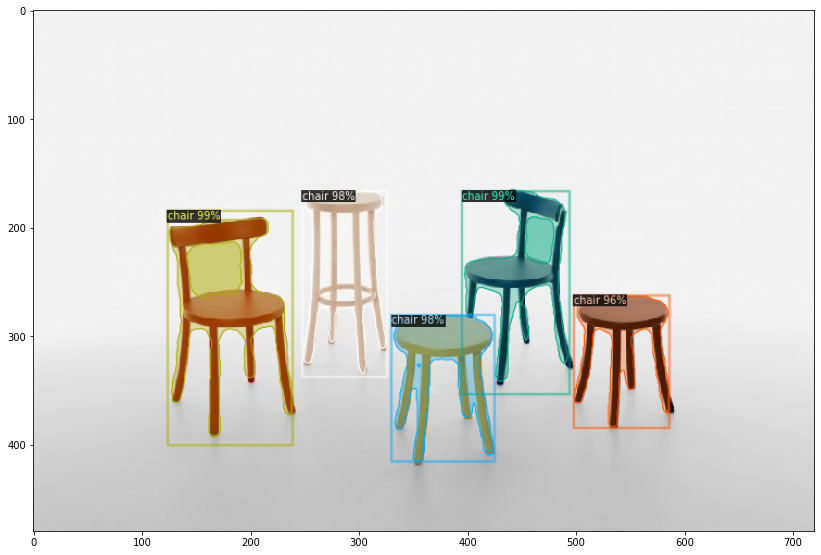

...

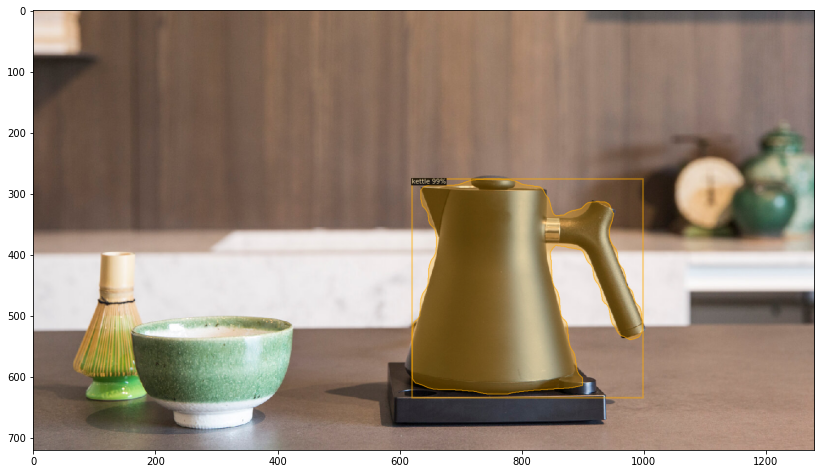

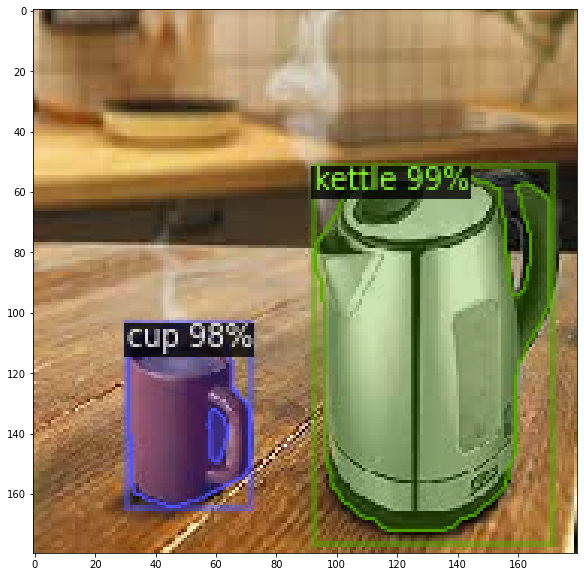

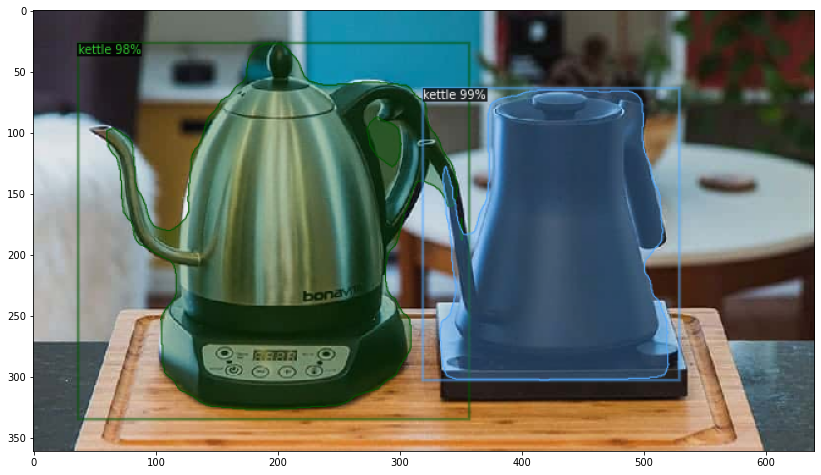

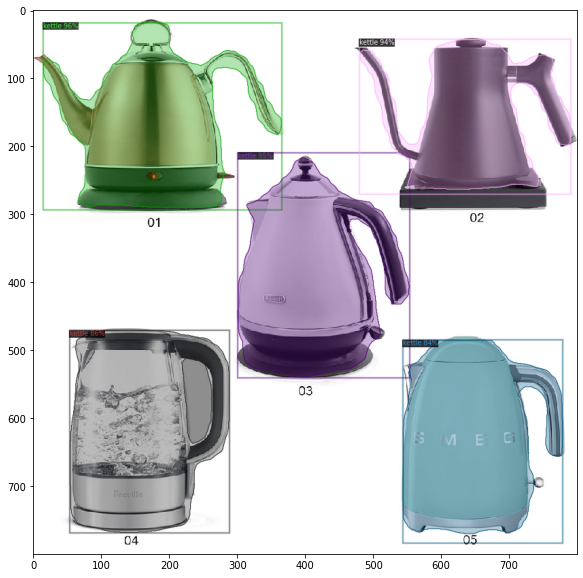

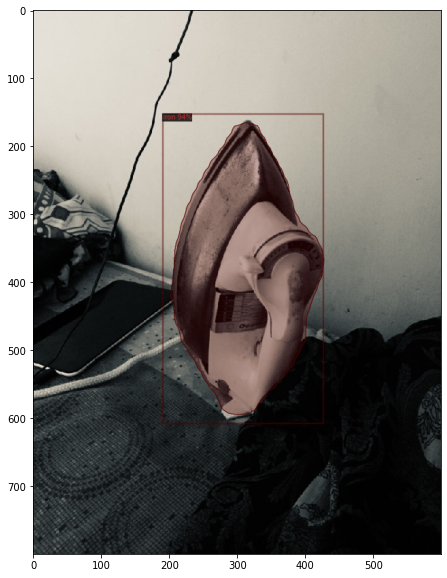

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

from os import listdir
from os.path import isfile, join

 
mypath='drive/MyDrive/Image Segmentation/test'
onlyfiles = [ f for f in listdir(mypath) if isfile(join(mypath,f)) ]
images = np.empty(len(onlyfiles), dtype=object)
for n in range(0, len(onlyfiles)):
   
    im = cv2.imread( join(mypath,onlyfiles[n]) )
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=indoor_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu")) #Passing the predictions to CPU from the GPU
    plt.figure(figsize = (14, 10))      # Setting the picture size
    plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

#Evaluating the Model
### Typically, models are evaluated according to COCO evaluation criteria.The average accuracy (mAP) is used to evaluate the performance of the model.
### This is done following the official documentation of Detectron2 under Evaluators for Custom Dataset
https://detectron2.readthedocs.io/en/latest/tutorials/evaluation.html

### For evaluation, please goto training the model code and uncomment these two lines of code
cfg.DATASETS.TEST = ("indoor_validation",)

cfg.TEST.EVAL_PERIOD = 2000

In [ ]:
#import the COCO Evaluator to use the COCO Metrics
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

#Call the COCO Evaluator function and pass the Validation Dataset
evaluator = COCOEvaluator("indoor_validation", cfg, False, output_dir="/output/")
val_loader = build_detection_test_loader(cfg, "indoor_validation")

#Use the created predicted model in the previous step
inference_on_dataset(predictor.model, val_loader, evaluator)